# Open Street Map Exploration of Plovdiv

This file contains some EDA from OpenStreetMap of the Bulgarian city of Plovdiv. It should be kept in mind that data is taken from OSM, so it may be that not everything is coded, but still a general idea should be able to be taken into account.

#### Imports

In [1]:
import pyrosm
from pyrosm.data import sources
import matplotlib.pyplot as plt

In [2]:
import geopandas as gpd

### Plovdiv geojson file

In [3]:
municipalities = gpd.read_file("C:\\Users\\User\\Documents\\UNITN\\Geospatial\\raster\\municipalities.geojson")
municipalities.crs #4326
plovdiv_city = municipalities[municipalities.nuts4 == "PDV22"]
plovdiv_city

,nuts4,nuts3,geometry
260,PDV22,PDV,"POLYGON ((24.76400 42.19200, 24.77800 42.17600..."


In [4]:
plovdiv_city['name'] = "Plovdiv"

c:\Users\User\anaconda3\envs\geospatialenv\lib\site-packages\geopandas\geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


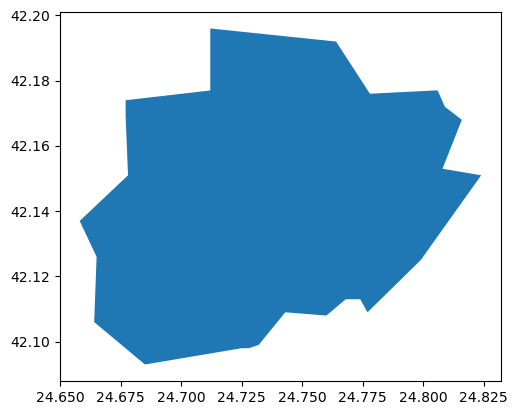

In [5]:
plovdiv_city.plot()

In [6]:
plovdiv_city.explore()

In [7]:
plovdiv_city.to_crs(32635).geometry.area/10**6

260    101.201118
dtype: float64

In [8]:
bbox_geom = plovdiv_city['geometry'].values[0]

# Exploring Plovdiv

Data (pbf) exported using BBBike data (https://extract.bbbike.org/)

In [9]:
osm3 = pyrosm.OSM(r"C:\Users\User\Documents\UNITN\Geospatial\raster\osm_pbf\bbbike\planet_24.658,42.104_24.824,42.184.osm.pbf", bounding_box= bbox_geom)

In [10]:
osm3.conf.tags.available

['aerialway',
 'aeroway',
 'amenity',
 'boundary',
 'building',
 'craft',
 'emergency',
 'geological',
 'highway',
 'historic',
 'landuse',
 'leisure',
 'natural',
 'office',
 'power',
 'public_transport',
 'railway',
 'route',
 'place',
 'shop',
 'tourism',
 'waterway']

## Buildings of Plovdiv

Even though not buildings are actually coded, we canget an idea of what and where is located.

c:\Users\User\anaconda3\envs\geospatialenv\lib\site-packages\geopandas\array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  warnings.warn(


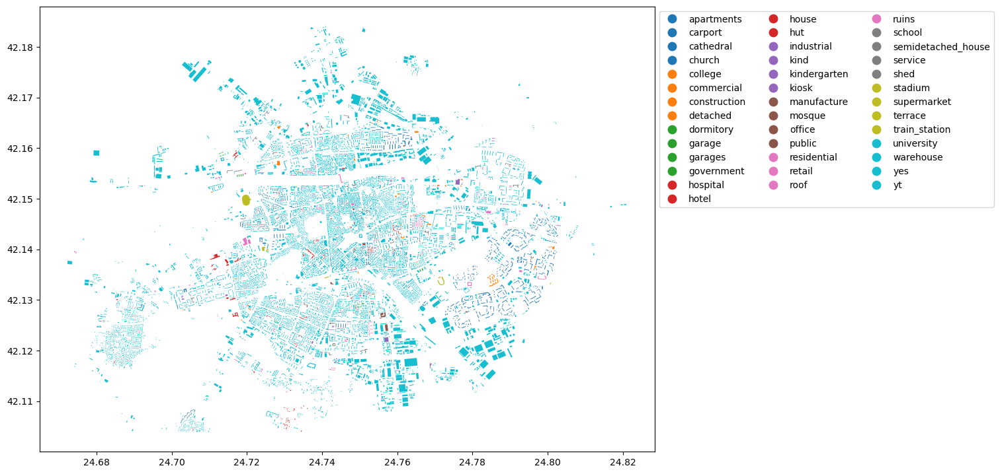

In [11]:
buildings = osm3.get_buildings()
buildings.plot(column="building", figsize=(12,12), legend=True, legend_kwds=dict(loc='upper left', ncol=3, bbox_to_anchor=(1, 1)))
plt.show()

In [12]:
buildings.explore(column = 'building')

In [13]:
import contextily as cx

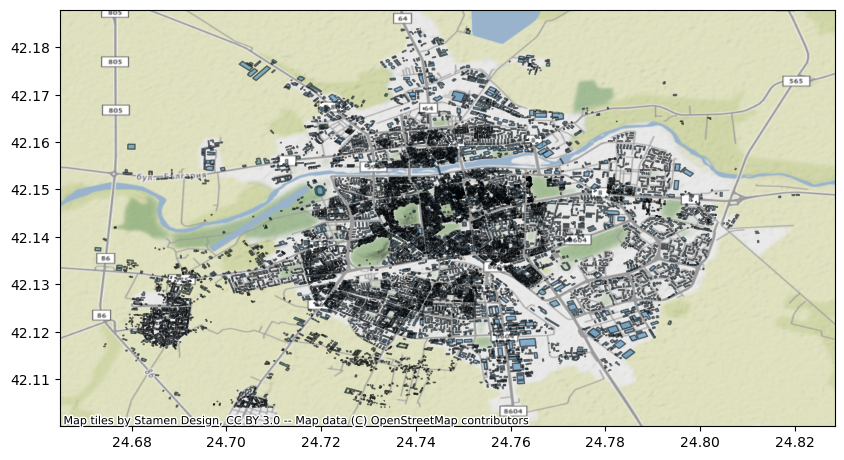

In [14]:
ax = buildings.plot(figsize=(10, 10), alpha=0.5, edgecolor='k')
cx.add_basemap(ax, crs=buildings.crs )# source=cx.providers.Stamen.TonerLite)

In [15]:
buildings.columns

Index(['addr:city', 'addr:country', 'addr:housenumber', 'addr:housename',
       'addr:postcode', 'addr:place', 'addr:street', 'email', 'name',
       'opening_hours', 'operator', 'phone', 'ref', 'url', 'website',
       'building', 'amenity', 'building:flats', 'building:levels', 'craft',
       'height', 'internet_access', 'office', 'shop', 'source', 'start_date',
       'wikipedia', 'id', 'timestamp', 'version', 'tags', 'osm_type',
       'geometry', 'changeset'],
      dtype='object')

In [16]:
#buildings.groupby(['building'])['building'].count().reset_index(name='count').sort_values(['count'], ascending=False)

## Landuse

c:\Users\User\anaconda3\envs\geospatialenv\lib\site-packages\geopandas\array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  warnings.warn(


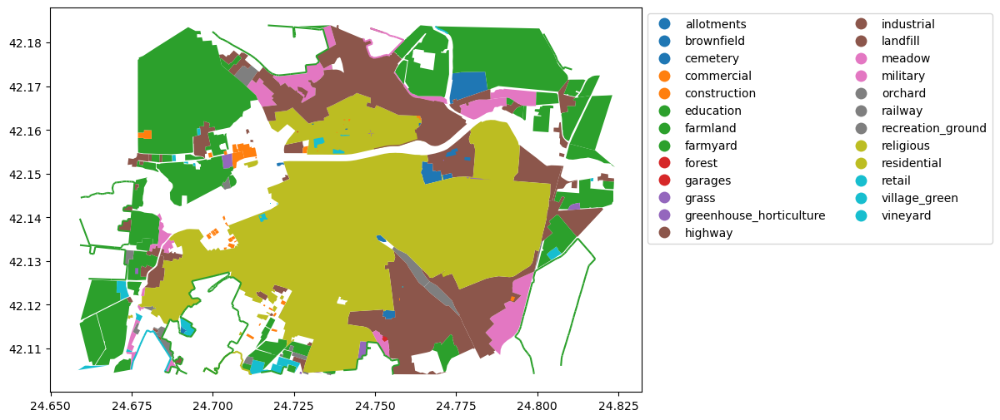

In [17]:
landuse = osm3.get_landuse()
landuse.plot(column='landuse', legend=True, legend_kwds=dict(loc='upper left', ncol=2, bbox_to_anchor=(1, 1)), figsize=(10,6))

In [18]:
landuse.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

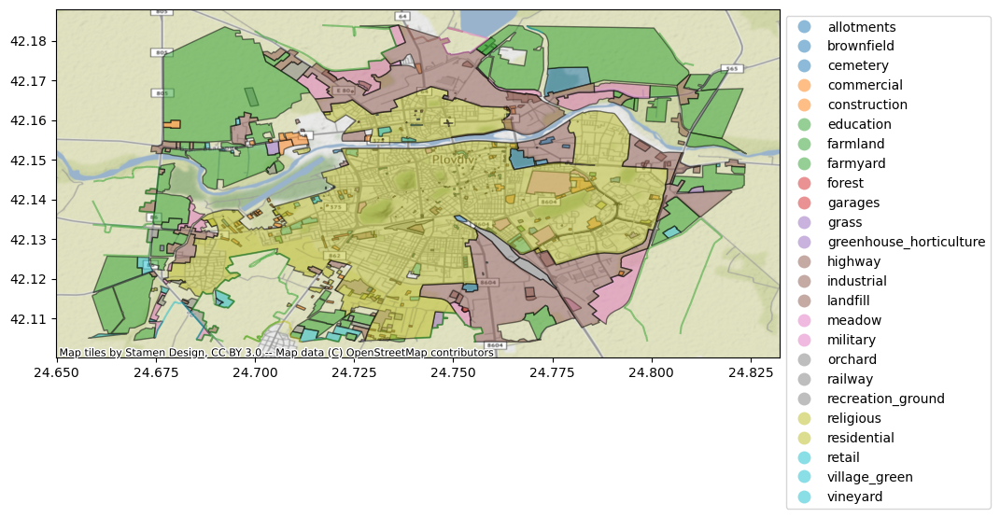

In [19]:
ax = landuse.plot(column = 'landuse', legend = True, legend_kwds=dict(loc='upper left', ncol=1, bbox_to_anchor=(1, 1)), figsize=(10, 10), alpha=0.5, edgecolor='k')
cx.add_basemap(ax, crs=landuse.crs )

In [20]:
landuse.explore(column = "landuse")

In [21]:
area = landuse.to_crs(epsg=32634).geometry.area
area = area / 10**6 #in sq km
#area.sort_values(ascending=False).head(10) 

In [22]:
landuse['area'] = area

In [23]:
landuse.groupby(['landuse'])['area'].sum().reset_index(name='sum').sort_values(['sum'], ascending=False)

,landuse,sum
21,residential,33.240397
6,farmland,21.395022
13,industrial,16.462308
15,meadow,3.252752
16,military,0.880402
2,cemetery,0.858480
4,construction,0.669402
17,orchard,0.665111
24,vineyard,0.626220
18,railway,0.610680


In [24]:
landuse.landuse.unique()

array(['construction', 'military', 'cemetery', 'industrial', 'grass',
       'brownfield', 'railway', 'garages', 'education', 'orchard',
       'meadow', 'recreation_ground', 'religious', 'farmland',
       'village_green', 'residential', 'commercial', 'vineyard',
       'greenhouse_horticulture', 'farmyard', 'highway', 'retail',
       'forest', 'allotments', 'landfill'], dtype=object)

It seems the city is fairly well balanced in terms of greenery and industrial/urban factors.

In [25]:
residential = landuse[(landuse.landuse == "residential")]
industrial = landuse[(landuse.landuse == "industrial") ]

In [26]:
green_landuse = landuse[(landuse.landuse == "farmland") | (landuse.landuse == "forest")| (landuse.landuse == "grass")| (landuse.landuse == "greenfield")] # most important greenery

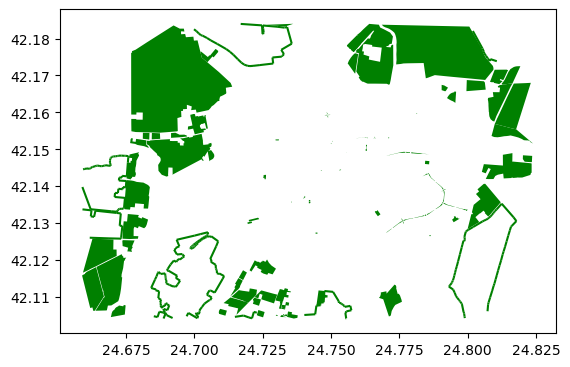

In [27]:
green_landuse.plot(color = "green") # Concentrated on the suburbs

In [28]:
green_landuse['area'].sum()/landuse['area'].sum() #percentage of the greenery

0.27077458706659013

In [29]:
residential['area'].sum()/landuse['area'].sum() #percentage of the residential

0.4101243412751048

In [30]:
industrial['area'].sum()/landuse['area'].sum() #percentage of the industrial

0.2031140986076837

## Natural

c:\Users\User\anaconda3\envs\geospatialenv\lib\site-packages\pyrosm\pyrosm.py:382: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  gdf = get_natural_data(
c:\Users\User\anaconda3\envs\geospatialenv\lib\site-packages\geopandas\array.py:1406: UserWarning: CRS not set for some of the concatenation inputs. Setting output's CRS as WGS 84 (the single non-null crs provided).
  warnings.warn(


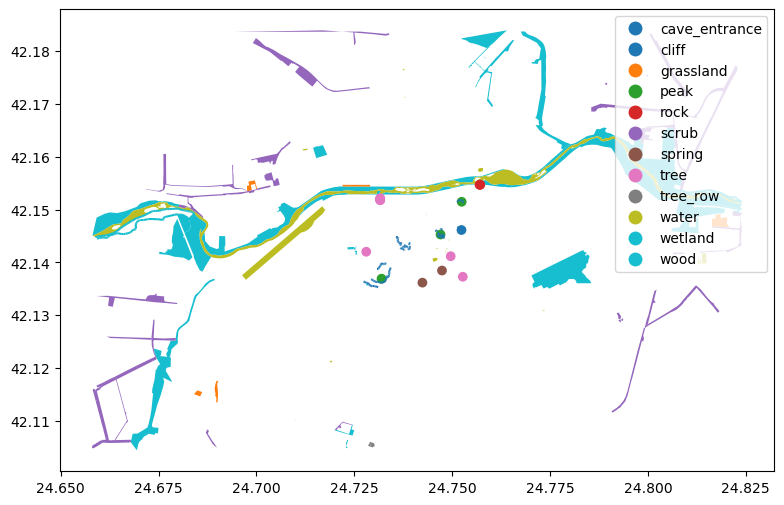

In [31]:
natural = osm3.get_natural()
natural.plot(column='natural', legend=True, figsize=(10,6))

## Network allocation

## Walking

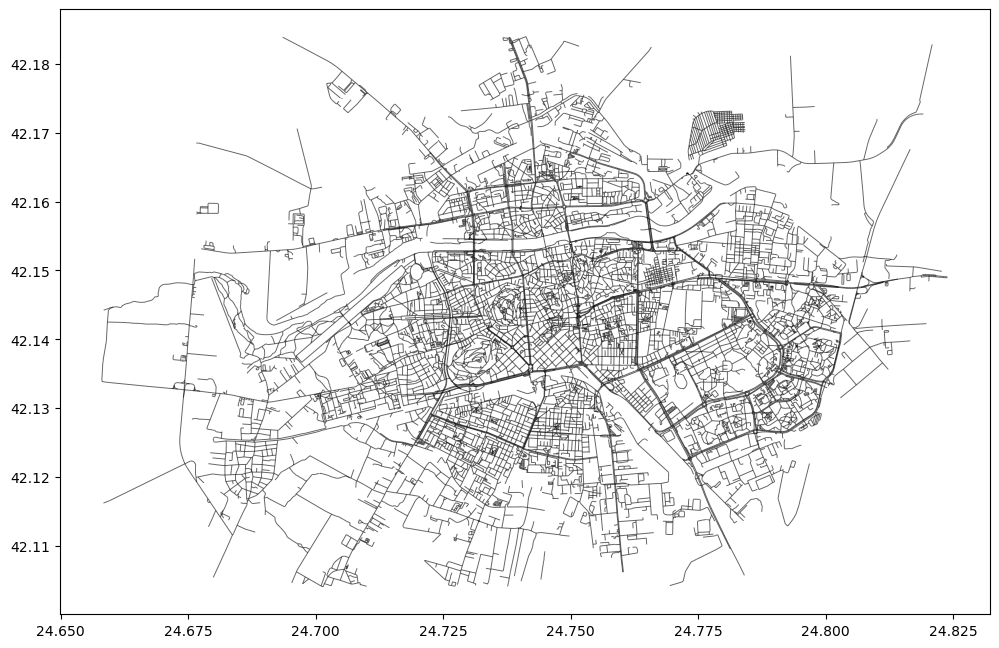

In [32]:
walk = osm3.get_network("walking")
walk.plot(color="k", figsize=(12,12), lw=0.7, alpha=0.6)

In [51]:
street_dzhendem = walk[walk.id == 98195935]

In [53]:
street_dzhendem.to_file(r"C:\Users\User\Documents\UNITN\Geospatial\raster\osm_pbf\street_dzendem_plovdiv.geojson", driver = "GeoJSON")

In [43]:
dzehdemtepe_bbox = (11.1505197, 46.0664359, 11.1530713, 46.0684635)

AttributeError: 'Location' object has no attribute 'explore'

In [35]:
walk.to_crs(32634).length.sum()/1000 #kms

1203.4122953066615

In [36]:
green_area = green_landuse.geometry.unary_union
industrial_area = industrial.geometry.unary_union
residential_area = residential.geometry.unary_union


## Cycling

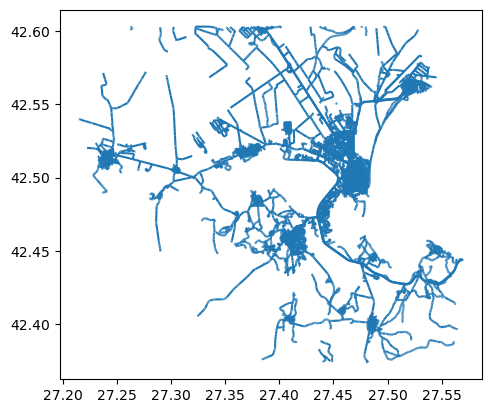

In [22]:
burgas_cycling = osm3.get_network(network_type = "cycling")
burgas_cycling['geom_type'] = burgas_cycling.geometry.geom_type
burgas_cycling.plot()

## Driving

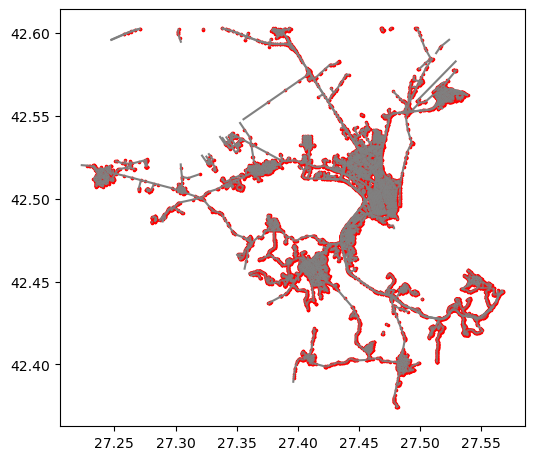

In [14]:
nodes, edges = osm3.get_network(nodes=True, network_type="driving")

# Plot nodes and edges on a map
ax = edges.plot(figsize=(6,6), color="gray")
ax = nodes.plot(ax=ax, color="red", markersize=2.5)